In [71]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from bs4 import BeautifulSoup 
import requests
import seaborn as sns
import warnings
import calendar

warnings.filterwarnings("ignore")

In [72]:
accidentes= pd.read_csv('./DATA/accidentes.csv')


In [73]:
accidentes

,ID,VICTIMAS,FECHA,ANIO,MES,DIA,HORA,MEDIO,COMUNA,X,Y,PARTICIPANTES,ACUSADO,ROL,DAMNIFICADO,SEXO,EDAD,OBITO
0,2016-0001,1,2016-01-01,2016,1,1,04:00:00,AVENIDA,8,-58.475340,-34.687570,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,19,1.0
1,2016-0002,1,2016-01-02,2016,1,2,01:15:00,AUTOPISTA,9,-58.508775,-34.669777,AUTO-PASAJEROS,PASAJEROS,CONDUCTOR,AUTO,MASCULINO,70,1.0
2,2016-0003,1,2016-01-03,2016,1,3,07:00:00,AVENIDA,1,-58.390403,-34.631894,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,30,1.0
3,2016-0004,1,2016-01-10,2016,1,10,00:00:00,AVENIDA,8,-58.465039,-34.680930,MOTO-SD,DESCONOCIDO,CONDUCTOR,MOTO,MASCULINO,18,1.0
4,2016-0005,1,2016-01-21,2016,1,21,05:20:00,AVENIDA,1,-58.387183,-34.622466,MOTO-PASAJEROS,PASAJEROS,CONDUCTOR,MOTO,MASCULINO,29,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26569,LC-2021-0652849,1,2021-12-31,2021,12,31,19:30:00,AVENIDA,9,-58.513477,-34.659714,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,29,0.0
26570,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,28,0.0
26571,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,52,0.0
26572,LC-2021-0652907,1,2021-12-31,2021,12,31,20:00:00,DESCONOCIDO,1,-58.382894,-34.583083,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,23,0.0


In [74]:
accidentes['OBITO'] = pd.to_numeric(accidentes['OBITO'], errors='coerce').astype('Int64') #Paso nuevamente la columna 'OBITO' a enteros, yaque al guardar el dataframe a csv a la hora de cargarlos los vuelve a poner en Float


In [75]:
accidentes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26574 entries, 0 to 26573
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   ID             26574 non-null  object 
 1   VICTIMAS       26574 non-null  int64  
 2   FECHA          26574 non-null  object 
 3   ANIO           26574 non-null  int64  
 4   MES            26574 non-null  int64  
 5   DIA            26574 non-null  int64  
 6   HORA           26574 non-null  object 
 7   MEDIO          26574 non-null  object 
 8   COMUNA         26574 non-null  int64  
 9   X              26561 non-null  float64
 10  Y              26561 non-null  float64
 11  PARTICIPANTES  26574 non-null  object 
 12  ACUSADO        26574 non-null  object 
 13  ROL            26574 non-null  object 
 14  DAMNIFICADO    26574 non-null  object 
 15  SEXO           26574 non-null  object 
 16  EDAD           26574 non-null  int64  
 17  OBITO          25966 non-null  Int64  
dtypes: Int

In [76]:
accidentes['FECHA'] = pd.to_datetime(accidentes['FECHA'], errors='coerce') #Acomodo la forma en que se representa la fecha

In [77]:
accidentes['SEMESTRE'] = (accidentes['FECHA'].dt.month - 1) // 6 + 1 #creo la columna Semestres que luego necesitaré


In [78]:
accidentes["OBITO"] = accidentes["OBITO"].dropna()


In [79]:
accidentes

,ID,VICTIMAS,FECHA,ANIO,MES,DIA,HORA,MEDIO,COMUNA,X,Y,PARTICIPANTES,ACUSADO,ROL,DAMNIFICADO,SEXO,EDAD,OBITO,SEMESTRE
0,2016-0001,1,2016-01-01,2016,1,1,04:00:00,AVENIDA,8,-58.475340,-34.687570,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,19,1,1
1,2016-0002,1,2016-01-02,2016,1,2,01:15:00,AUTOPISTA,9,-58.508775,-34.669777,AUTO-PASAJEROS,PASAJEROS,CONDUCTOR,AUTO,MASCULINO,70,1,1
2,2016-0003,1,2016-01-03,2016,1,3,07:00:00,AVENIDA,1,-58.390403,-34.631894,MOTO-AUTO,AUTO,CONDUCTOR,MOTO,MASCULINO,30,1,1
3,2016-0004,1,2016-01-10,2016,1,10,00:00:00,AVENIDA,8,-58.465039,-34.680930,MOTO-SD,DESCONOCIDO,CONDUCTOR,MOTO,MASCULINO,18,1,1
4,2016-0005,1,2016-01-21,2016,1,21,05:20:00,AVENIDA,1,-58.387183,-34.622466,MOTO-PASAJEROS,PASAJEROS,CONDUCTOR,MOTO,MASCULINO,29,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26569,LC-2021-0652849,1,2021-12-31,2021,12,31,19:30:00,AVENIDA,9,-58.513477,-34.659714,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,29,0,2
26570,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,28,0,2
26571,LC-2021-0652865,2,2021-12-31,2021,12,31,19:40:00,AVENIDA,9,-58.488327,-34.641753,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,52,0,2
26572,LC-2021-0652907,1,2021-12-31,2021,12,31,20:00:00,DESCONOCIDO,1,-58.382894,-34.583083,MOTO,DESCONOCIDO,DESCONOCIDO,DESCONOCIDO,MASCULINO,23,0,2


In [80]:
#Divido los dataframes en 2, una exclusivo con Fallecimientos 'obitos', y el otro solo con lesiones, tengo los 2 fusionados en 'accidentes'
accidentes_obitos= accidentes[accidentes['OBITO'] == 1].copy()
accidentes_lesiones= accidentes[accidentes['OBITO'] == 0].copy()

### VICTIMAS POR COMUNA

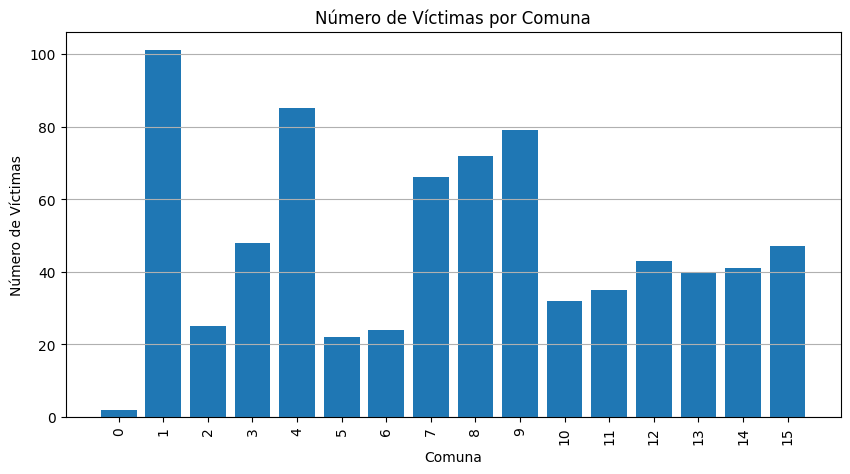

In [81]:

# Agrupo por comuna y sumo las víctimas
victimas_por_comuna = accidentes_obitos.groupby('COMUNA')['VICTIMAS'].sum().reset_index()

# Filtro comunas con víctimas
victimas_por_comuna = victimas_por_comuna[victimas_por_comuna['VICTIMAS'] > 0]

# Ajusto los índices para que coincidan con la posición en el eje x
victimas_por_comuna = victimas_por_comuna.reset_index(drop=True)

plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_por_comuna.index, victimas_por_comuna['VICTIMAS'])
plt.title('Número de Víctimas por Comuna')
plt.xlabel('Comuna')
plt.ylabel('Número de Víctimas')
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_por_comuna.index)), victimas_por_comuna['COMUNA'], rotation=90)
plt.grid(axis='y')
plt.show()

Puedo ver que las Comunas con mas incidencias de accidentes con fallecimientos son las Comunas 1, 4, 9, 8 y 7 

### ANUAL

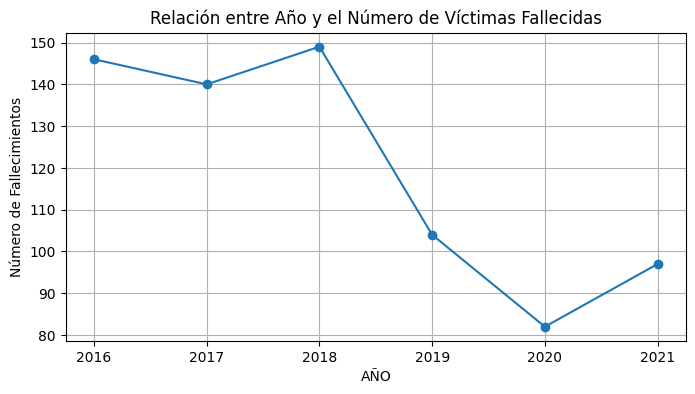

In [82]:
victimas_anual_o = accidentes_obitos.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual_o['ANIO'], victimas_anual_o['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Fallecidas')
plt.xlabel('AÑO')
plt.ylabel('Número de Fallecimientos')
plt.grid(True)

plt.show()

Analizo como fue cambiando la cantidad de victimas fatales a lo largo de los años dados, desde el 2016 al 2021, puedo ver que para el 2020 la cantidad de fallecimientos disminuye notablemente, esto tiene dos teorias, aplicación de estrategias y normas de seguridad de forma correcta para prevenir muertes y tambien el aislamientos ymayor control que tuvimos en pandemia

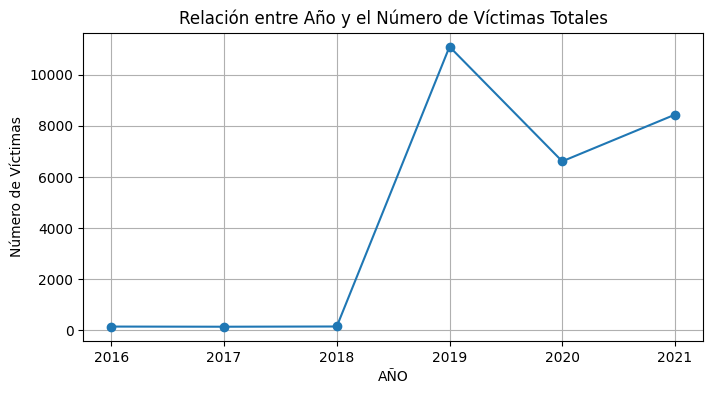

In [83]:
victimas_anual = accidentes.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))
plt.plot(victimas_anual['ANIO'], victimas_anual['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Totales')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas')
plt.grid(True)

plt.show()

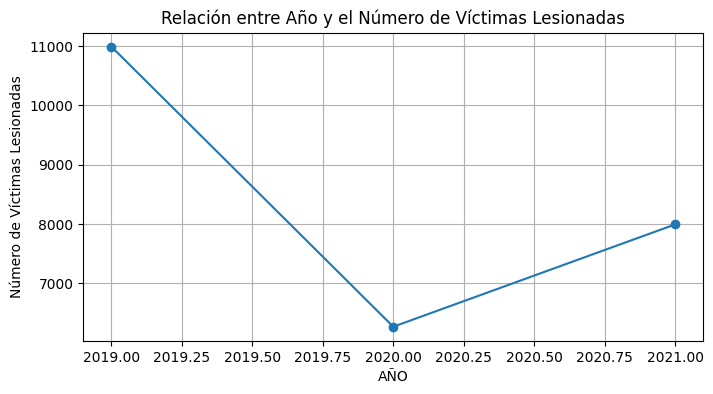

In [84]:
victimas_anual_lesiones = accidentes_lesiones.groupby('ANIO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(8, 4))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.plot(victimas_anual_lesiones['ANIO'], victimas_anual_lesiones['VICTIMAS'], marker='o', linestyle='-')
plt.title('Relación entre Año y el Número de Víctimas Lesionadas')
plt.xlabel('AÑO')
plt.ylabel('Número de Víctimas Lesionadas')
plt.grid(True)

plt.show()

#### MES

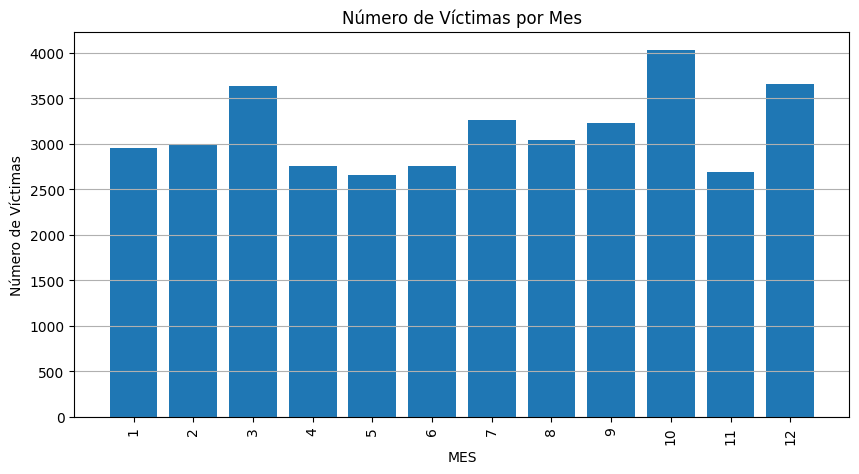

In [85]:
# Agrupo por comuna y sumo las víctimas
victimas_mes = accidentes.groupby('MES')['VICTIMAS'].sum().reset_index()

# Filtro comunas con víctimas
victimas_mes = victimas_mes[victimas_mes['VICTIMAS'] > 0]

# Ajusto los índices para que coincidan con la posición en el eje x
victimas_mes = victimas_mes.reset_index(drop=True)

plt.figure(figsize=(10, 5))
bars = plt.bar(victimas_mes.index, victimas_mes['VICTIMAS'])
plt.title('Número de Víctimas por Mes')
plt.xlabel('MES')
plt.ylabel('Número de Víctimas')
plt.xticks(rotation=90)
plt.xticks(range(len(victimas_mes.index)), victimas_mes['MES'], rotation=90)
plt.grid(axis='y')
plt.show()

Veo que los meses con mayor indice de accidentes con y sin victimas fatales dentro de CABA se dan los meses de finalización de ciclos lectivos, fin de año, ycomienzo de ciclos lectivos, tambien en las vacaciones de invierno se nota un leve aumento

### HORA

In [86]:
victimas_hora = ['HORA', 'VICTIMAS', 'OBITO']
accidentes_hora = accidentes[victimas_hora]

In [87]:
obitos_hora = ['HORA', 'VICTIMAS', 'OBITO']
accidentes_hora_o = accidentes_obitos[obitos_hora]

In [88]:
victimas_hora

['HORA', 'VICTIMAS', 'OBITO']

In [89]:
accidentes_hora = accidentes_hora[accidentes_hora['HORA'] != 'SD']

accidentes_hora['HORA'] = accidentes_hora['HORA'].str.slice(0, 2).astype('Int64')


In [90]:
accidentes_hora_o = accidentes_hora_o[accidentes_hora_o['HORA'] != 'SD']

accidentes_hora_o['HORA'] = accidentes_hora_o['HORA'].str.slice(0, 2).astype('Int64')

In [91]:
accidentes_hora['HORA'].unique()

<IntegerArray>
[ 4,  1,  7,  0,  5, 18, 19, 15, 11, 22, 16,  9, 23,  6, 10, 17, 12,  8, 20,
 21, 14,  3,  2, 13]
Length: 24, dtype: Int64

In [92]:
accidentes_hora_o['HORA'].unique()

<IntegerArray>
[ 4,  1,  7,  0,  5, 18, 19, 15, 11, 22, 16,  9, 23,  6, 10, 17, 12,  8, 20,
 21, 14,  3,  2, 13]
Length: 24, dtype: Int64

In [93]:
accidentes_hora

,HORA,VICTIMAS,OBITO
0,4,1,1
1,1,1,1
2,7,1,1
3,0,1,1
4,5,1,1
...,...,...,...
26569,19,1,0
26570,19,2,0
26571,19,2,0
26572,20,1,0


In [94]:
accidentes_hora_o

,HORA,VICTIMAS,OBITO
0,4,1,1
1,1,1,1
2,7,1,1
3,0,1,1
4,5,1,1
...,...,...,...
713,1,1,1
714,0,1,1
715,10,1,1
716,6,1,1


Acomodé las horas para ser utilizadas de forma mas práctica y las guardé en un archivo csv

In [95]:
accidentes_hora.to_csv('DATA/accidentes_hora.csv', index=False)


In [96]:
accidentes_hora_o.to_csv('DATA/accidentes_hora_o.csv', index=False)


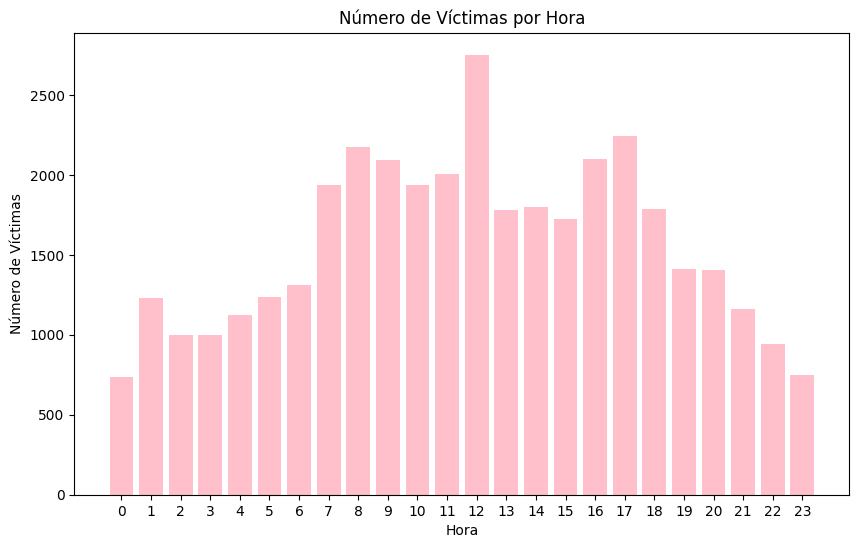

In [97]:
victimas_por_hora = accidentes_hora.groupby('HORA')['VICTIMAS'].sum().reset_index()
horas_completas = pd.DataFrame({'HORA': range(0, 24)}).set_index('HORA')
victimas_por_hora = horas_completas.merge(victimas_por_hora, how='left', left_index=True, right_on='HORA').fillna(0)
plt.figure(figsize=(10, 6))
plt.bar(victimas_por_hora['HORA'], victimas_por_hora['VICTIMAS'], color='pink')
plt.title('Número de Víctimas por Hora')
plt.xlabel('Hora')
plt.ylabel('Número de Víctimas')
plt.xticks(range(24))  # Mostrar todas las horas en el eje X
plt.show()

Veo que la mayor incidencia de accidentes resultan en los horarios pico, donde se aglomera la gente al salir o entrar al trabajo, o llevar a los niños a la escuela o buscarlos, las 12, 16, 17, 7, 8 y 9, son horas claves para el movimiento de la sociedad en CABA

## ROL

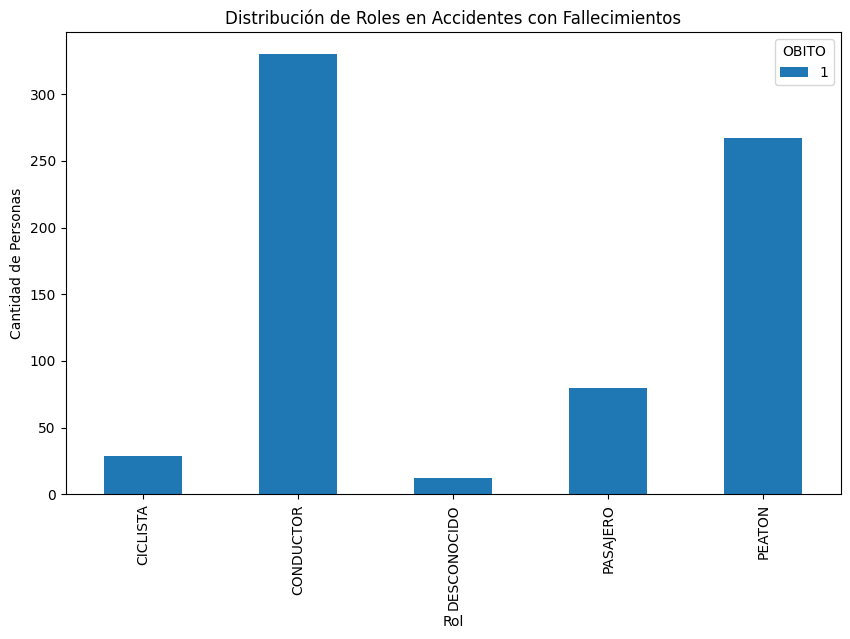

In [98]:
conteo_roles = accidentes_obitos.groupby(['ROL', 'OBITO']).size().unstack(fill_value=0)

conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles en Accidentes con Fallecimientos')
plt.xlabel('Rol')
plt.ylabel('Cantidad de Personas')
plt.show()

La mayor incidencia de muertes las tienen los Conductores

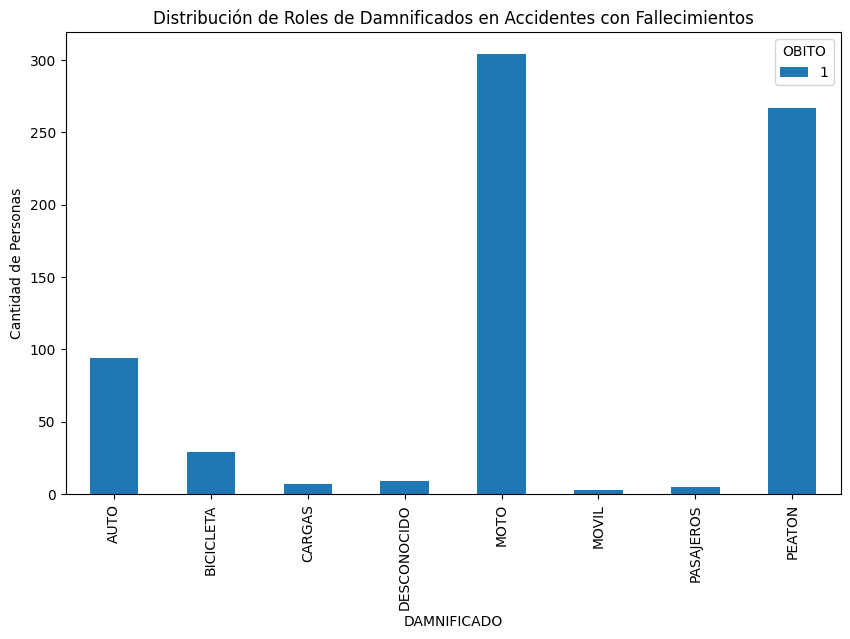

In [99]:
conteo_roles = accidentes_obitos.groupby(['DAMNIFICADO', 'OBITO']).size().unstack(fill_value=0)
conteo_roles.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Distribución de Roles de Damnificados en Accidentes con Fallecimientos')
plt.xlabel('DAMNIFICADO')
plt.ylabel('Cantidad de Personas')
plt.show()

Motos y peatones se llevan los indices de mayores fallecimientos en accidentes de tránsito

### VICTIMAS POR GÉNERO

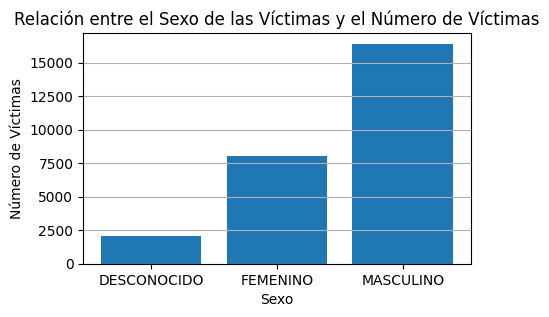

In [100]:

victimas_por_sexo = accidentes.groupby('SEXO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo['SEXO'], victimas_por_sexo['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')
plt.show()


Los hombres suelen ser quienes mas accidentes tienen, esto puede deberse a muchos factores que puedo intuir pero que no poseo datos para sugerir

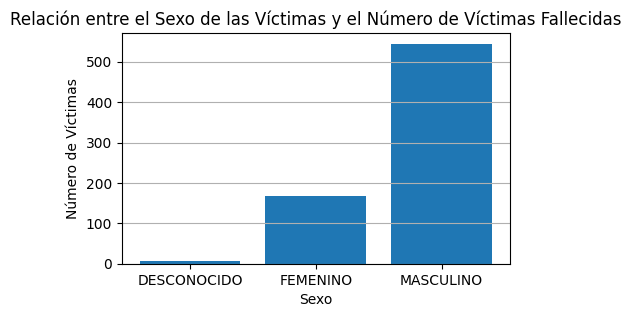

In [101]:
victimas_por_sexo_o = accidentes_obitos.groupby('SEXO')['VICTIMAS'].count().reset_index()

plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo_o['SEXO'], victimas_por_sexo_o['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas Fallecidas')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')
plt.show()

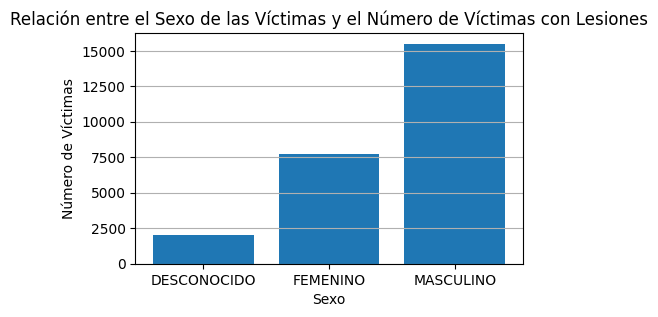

In [102]:

victimas_por_sexo_l = accidentes_lesiones.groupby('SEXO')['VICTIMAS'].count().reset_index()
plt.figure(figsize=(5, 3))  # Ajusta el tamaño de la gráfica según tus preferencias
plt.bar(victimas_por_sexo_l['SEXO'], victimas_por_sexo_l['VICTIMAS'])
plt.title('Relación entre el Sexo de las Víctimas y el Número de Víctimas con Lesiones')
plt.xlabel('Sexo')
plt.ylabel('Número de Víctimas')
plt.grid(axis='y')

plt.show()

### VICTIMAS POR EDAD

In [103]:
columnasres = ['EDAD', 'VICTIMAS', 'OBITO']
accidentes_edad = accidentes[columnasres]

In [104]:
accidentes_edad

,EDAD,VICTIMAS,OBITO
0,19,1,1
1,70,1,1
2,30,1,1
3,18,1,1
4,29,1,1
...,...,...,...
26569,29,1,0
26570,28,2,0
26571,52,2,0
26572,23,1,0


In [105]:
bins = [0, 12, 19, 40, 65, float('inf')]
labels = ['NIÑXS', 'ADOLESCENTES', 'JOVENES', 'MAYORES', 'ANCIANOS']

accidentes_edad['RANGO'] = pd.cut(accidentes_edad['EDAD'], bins=bins, labels=labels, right=False)


In [106]:
accidentes_edad

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
26569,29,1,0,JOVENES
26570,28,2,0,JOVENES
26571,52,2,0,MAYORES
26572,23,1,0,JOVENES


In [107]:
apariciones_por_rango = accidentes_edad['RANGO'].value_counts().sort_index()
apariciones_por_rango


RANGO
NIÑXS            4581
ADOLESCENTES      569
JOVENES         12924
MAYORES          6971
ANCIANOS         1529
Name: count, dtype: int64

In [108]:
# OBITO igual a 1 (accidentes mortales)
accidentes_edad_obito = accidentes_edad[accidentes_edad['OBITO'] == 1]

# OBITO igual a 0 (accidentes con lesiones)
accidentes_edad_lesiones = accidentes_edad[accidentes_edad['OBITO'] == 0]

In [109]:
accidentes_edad_obito

,EDAD,VICTIMAS,OBITO,RANGO
0,19,1,1,JOVENES
1,70,1,1,ANCIANOS
2,30,1,1,JOVENES
3,18,1,1,ADOLESCENTES
4,29,1,1,JOVENES
...,...,...,...,...
713,43,1,1,MAYORES
714,27,1,1,JOVENES
715,60,1,1,MAYORES
716,53,1,1,MAYORES


In [110]:
obito_por_rango = accidentes_edad_obito['RANGO'].value_counts().sort_index()
obito_por_rango


RANGO
NIÑXS            62
ADOLESCENTES     21
JOVENES         337
MAYORES         186
ANCIANOS        112
Name: count, dtype: int64

In [111]:
accidentes_edad_lesiones

,EDAD,VICTIMAS,OBITO,RANGO
717,0,1,0,NIÑXS
718,57,1,0,MAYORES
719,0,1,0,NIÑXS
720,0,1,0,NIÑXS
721,45,4,0,MAYORES
...,...,...,...,...
26568,58,1,0,MAYORES
26569,29,1,0,JOVENES
26570,28,2,0,JOVENES
26571,52,2,0,MAYORES


In [112]:
lesiones_por_rango = accidentes_edad_lesiones['RANGO'].value_counts().sort_index()
lesiones_por_rango

RANGO
NIÑXS            4396
ADOLESCENTES      535
JOVENES         12306
MAYORES          6631
ANCIANOS         1380
Name: count, dtype: int64

In [113]:
lesiones_por_rango.to_csv('DATA/lesiones_por_rango.csv', index=True)
obito_por_rango.to_csv('DATA/obitos_rango.csv', index=True)


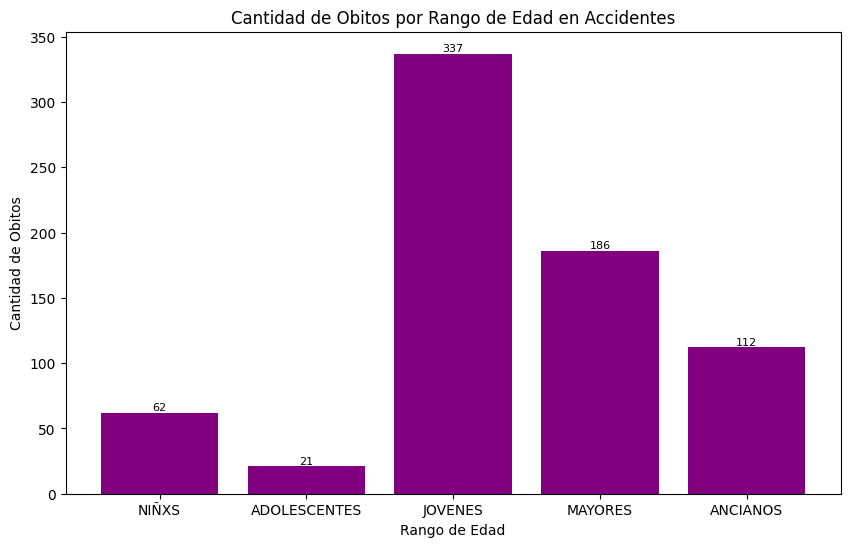

In [114]:
plt.figure(figsize=(10, 6))
bars = plt.bar(obito_por_rango.index, obito_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Obitos')
plt.title('Cantidad de Obitos por Rango de Edad en Accidentes')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

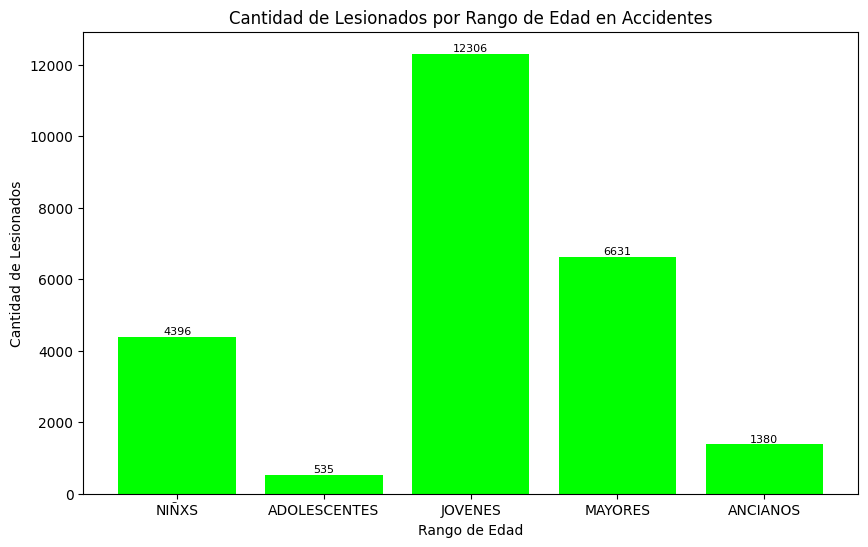

In [115]:
plt.figure(figsize=(10, 6))
bars = plt.bar(lesiones_por_rango.index, lesiones_por_rango, color='lime')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Lesionados')
plt.title('Cantidad de Lesionados por Rango de Edad en Accidentes')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

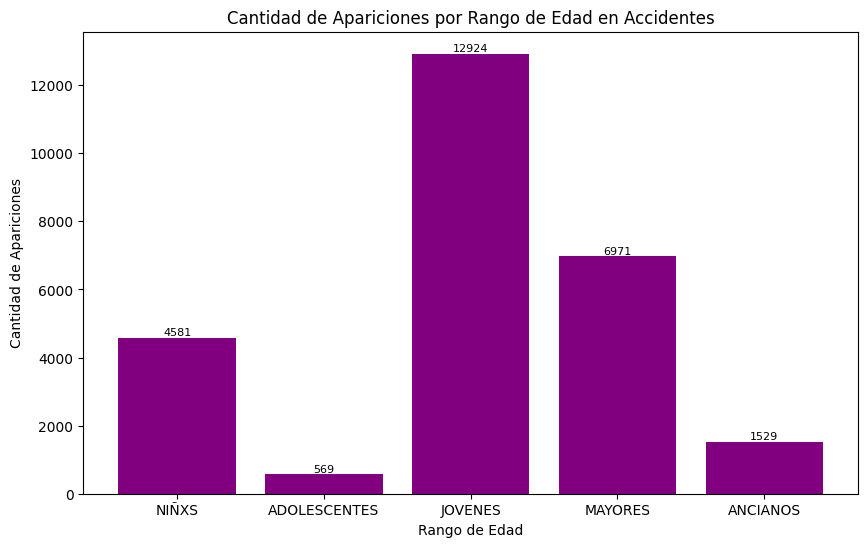

In [116]:
plt.figure(figsize=(10, 6))
bars = plt.bar(apariciones_por_rango.index, apariciones_por_rango, color='purple')
plt.xlabel('Rango de Edad')
plt.ylabel('Cantidad de Apariciones')
plt.title('Cantidad de Apariciones por Rango de Edad en Accidentes')

for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom', color='black', fontsize=8)

plt.show()

Se puede ver claramente que los jovenes son quienes generar mayor cantidad de accidentes y por esa razón poseen un indice mas alto de mortalidad, los adolescentes no juegan con la misma suerte, tal vez se deba a que a esa edad utilizan mas forma de locomoción peatonal, ciclista, transporte público, en cmabio los niños quesiempre van con adultos tienen un indice mas elevado, pero aun asimenor que Mayores y en fallecimientos a Ancianos

### MEDIO

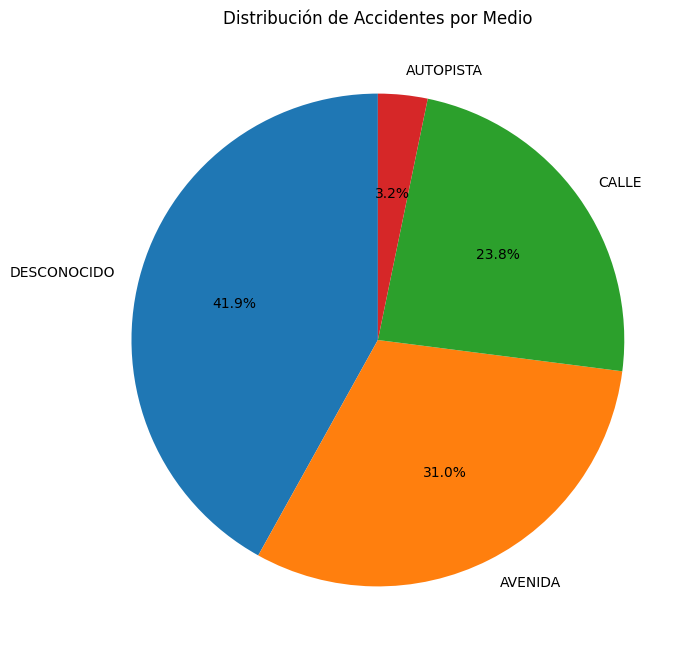

In [117]:
conteo_medios = accidentes['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios, labels=conteo_medios.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Accidentes por Medio')
plt.show()

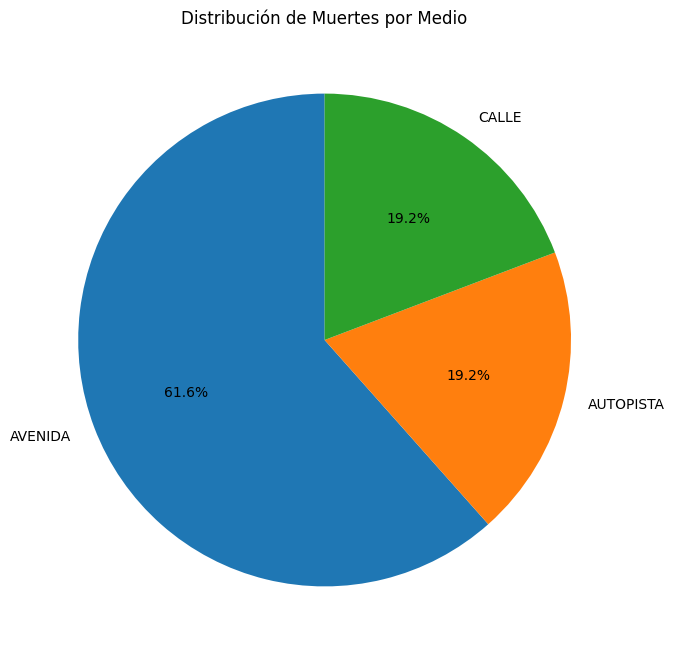

In [118]:
conteo_medios_o = accidentes_obitos['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios_o, labels=conteo_medios_o.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Muertes por Medio')
plt.show()

Las personas mueren mas en Avenidas, seguramente por la velocidad que toman en dichos recorridos

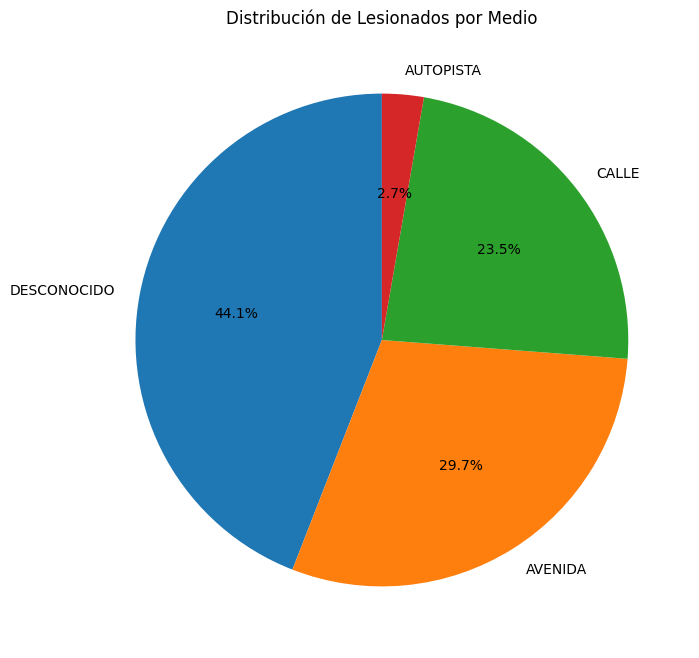

In [119]:
conteo_medios_l = accidentes_lesiones['MEDIO'].value_counts()

# Crear el gráfico de torta
plt.figure(figsize=(8, 8))
plt.pie(conteo_medios_l, labels=conteo_medios_l.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribución de Lesionados por Medio')
plt.show()

## KPI's

#### Con el fin de cumplimentar la verificación de los requerimientos (KPI) se realizó una busqueda de bases de datos mas fidedignas, en organismos de censo, del estado, privados, medios de comunición, enciclopedias, etc. Para por fin dar con un archivo que poseia los datos necesarios para seguir adelante, de estos datos solo se promediaran el total de población de CABA entre el 2016 y el 2021. Fuente 'https://data.buenosaires.gob.ar/dataset/barrios/resource/5040e8fe-ce16-4d08-a091-b1dbe53335f1'

In [120]:
poblacion = pd.read_csv('./DATA/PBP_CO_1020 - PBP_CO_1020.csv')

In [121]:
poblacion

,Proyecciones de población por comuna y sexo. Ciudad de Buenos Aires. Años 2010/2025,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16
0,Ambos sexos,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Comuna,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025
2,Total,3.028.481,3.033.639,3.038.860,3.044.076,3.049.229,3.054.267,3.059.122,3.063.728,3.068.043,3.072.029,3.075.646,3.078.836,3.081.550,3.083.770,3.085.483,3.086.680
3,1,243.946,245.308,246.689,248.069,249.433,250.770,252.053,253.271,254.408,255.457,256.405,257.235,257.934,258.497,258.922,259.205
4,2,150.714,150.573,150.428,150.278,150.130,149.985,149.848,149.720,149.607,149.510,149.430,149.371,149.337,149.328,149.345,149.389
5,3,191.323,191.536,191.750,191.963,192.171,192.375,192.573,192.763,192.945,193.115,193.276,193.425,193.560,193.682,193.790,193.884
6,4,234.933,235.497,236.071,236.646,237.214,237.769,238.303,238.809,239.279,239.712,240.100,240.437,240.716,240.937,241.096,241.193
7,5,185.301,185.544,185.789,186.034,186.276,186.512,186.740,186.956,187.159,187.348,187.518,187.670,187.800,187.907,187.991,188.053
8,6,183.046,183.309,183.576,183.843,184.105,184.363,184.611,184.846,185.067,185.271,185.456,185.620,185.760,185.875,185.964,186.028
9,7,236.838,237.389,237.946,238.505,239.057,239.597,240.116,240.607,241.065,241.484,241.861,242.188,242.460,242.674,242.828,242.921


In [122]:
# Obitos en accidentes de tránsito por semestres
obitos_semestre = accidentes_obitos.groupby(['ANIO', 'SEMESTRE'])['VICTIMAS'].sum()

# PRomedio de Población de CABA del 2016 al 2021
poblacion_caba =(3059122 + 3063728 + 3068043 + 3072029 + 3075646 + 3078836) / 6

# Tasa smestral de obitos en accidentes de tránsito
tasa_obitos_semestre = (obitos_semestre / poblacion_caba) * 100000

# Reducción en la tasa de obitos
reduccion_obitos = ((tasa_obitos_semestre.shift(-1) - tasa_obitos_semestre) / tasa_obitos_semestre) * 100

# Crear un DataFrame con ANIO, SEMESTRE, VICTIMA y TASA
tabla_obitos = pd.DataFrame({
    'ANIO': obitos_semestre.index.get_level_values('ANIO'),
    'SEMESTRE': obitos_semestre.index.get_level_values('SEMESTRE'),
    'VICTIMA': obitos_semestre.values,
    'TASA': tasa_obitos_semestre.values,
    'REDUCCION': reduccion_obitos.values
})


In [123]:
tabla_obitos["TASA"] = tabla_obitos["TASA"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [124]:
tabla_obitos["REDUCCION"] = tabla_obitos["REDUCCION"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [125]:
tabla_obitos

,ANIO,SEMESTRE,VICTIMA,TASA,REDUCCION
0,2016,1,67,"2,18","23,88"
1,2016,2,83,"2,70","-2,41"
2,2017,1,81,"2,64","-2,47"
3,2017,2,79,"2,57","-3,80"
4,2018,1,76,"2,48","11,84"
5,2018,2,85,"2,77","-30,59"
6,2019,1,59,"1,92","-20,34"
7,2019,2,47,"1,53","-34,04"
8,2020,1,31,"1,01","83,87"
9,2020,2,57,"1,86","-3,51"


In [126]:
obitos_semestre

ANIO  SEMESTRE
2016  1           67
      2           83
2017  1           81
      2           79
2018  1           76
      2           85
2019  1           59
      2           47
2020  1           31
      2           57
2021  1           55
      2           42
Name: VICTIMAS, dtype: int64

In [127]:
tasa_obitos_semestre

ANIO  SEMESTRE
2016  1           2.182718
      2           2.703964
2017  1           2.638808
      2           2.573653
2018  1           2.475919
      2           2.769120
2019  1           1.922095
      2           1.531160
2020  1           1.009914
      2           1.856939
2021  1           1.791783
      2           1.368271
Name: VICTIMAS, dtype: float64

In [128]:
reduccion_obitos

ANIO  SEMESTRE
2016  1           23.880597
      2           -2.409639
2017  1           -2.469136
      2           -3.797468
2018  1           11.842105
      2          -30.588235
2019  1          -20.338983
      2          -34.042553
2020  1           83.870968
      2           -3.508772
2021  1          -23.636364
      2                 NaN
Name: VICTIMAS, dtype: float64

<Axes: xlabel='ANIO,SEMESTRE'>

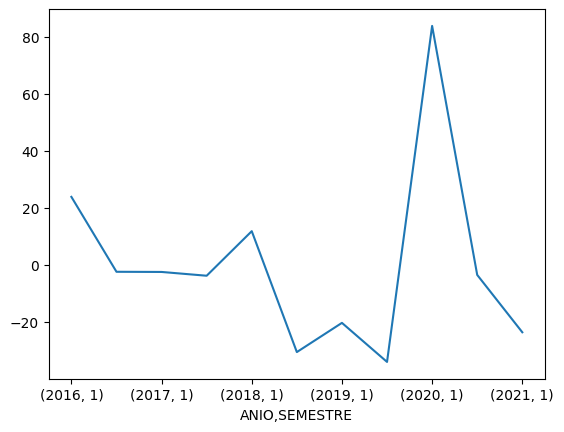

In [129]:
reduccion_obitos.plot()

### CONCLUSION
El presente indicador clave de rendimiento (KPI) se centra en evaluar la evolución de la tasa de homicidios en siniestros viales en la Ciudad Autónoma de Buenos Aires (CABA) a lo largo de varios años, comparando los dos últimos semestres. La tendencia general de este KPI experimenta variaciones anuales, observándose disminuciones significativas en algunos periodos y aumentos en otros. En el año 2020, se destacó un aumento sustancial en la tasa de homicidios durante el primer semestre (86.66%), seguido de una mejora en el segundo semestre (10%), posiblemente atribuible a factores como el impacto de la pandemia o medidas de seguridad vial. Respecto al año 2021, la falta de información, especialmente en el segundo semestre, complica una evaluación precisa del rendimiento. La comparación entre semestres revela que la reducción deseada del 10% se logra en algunos casos, mientras que en otros no. Sería beneficioso realizar un análisis más profundo de las causas detrás de las variaciones en la tasa de homicidios en siniestros viales, considerando posibles cambios en políticas de seguridad vial, mejoras en la infraestructura vial, o la influencia de eventos externos como la pandemia.

### KPI 2

In [130]:

# Obito anual de motociclistas
obito_moto_anual = accidentes_obitos[accidentes_obitos['DAMNIFICADO'] == 'MOTO'].groupby('ANIO')['ID'].count()

# Tasa anual de obitos en accidentes de tránsito para motociclistas
tasa_obitos_moto_anual = (obito_moto_anual / poblacion_caba) * 100000

# Tasa de cambio porcentual anual de la cantidad de accidentes mortales de motociclistas
reduccion_obitos_moto = (accidentes_obitos[accidentes_obitos['DAMNIFICADO'] == 'MOTO'].groupby('ANIO')['ID'].count().pct_change(fill_value=0) * 100)

# Crear un DataFrame con ANIO, VICTIMA, TASA y REDUCCION
tabla_obitos_moto = pd.DataFrame({
    'ANIO': obito_moto_anual.index,
    'VICTIMA': obito_moto_anual.values,
    'TASA': tasa_obitos_moto_anual.values,
    'REDUCCION': reduccion_obitos_moto.values
})


In [131]:
tabla_obitos_moto["TASA"] = tabla_obitos_moto["TASA"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [132]:
tabla_obitos_moto["REDUCCION"] = tabla_obitos_moto["REDUCCION"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [133]:
tabla_obitos_moto

,ANIO,VICTIMA,TASA,REDUCCION
0,2016,65,"2,12",inf
1,2017,56,"1,82","-13,85"
2,2018,57,"1,86","1,79"
3,2019,50,"1,63","-12,28"
4,2020,30,"0,98","-40,00"
5,2021,46,"1,50","53,33"


In [134]:
obito_moto_anual

ANIO
2016    65
2017    56
2018    57
2019    50
2020    30
2021    46
Name: ID, dtype: int64

In [135]:
reduccion_obitos_moto

ANIO
2016          inf
2017   -13.846154
2018     1.785714
2019   -12.280702
2020   -40.000000
2021    53.333333
Name: ID, dtype: float64

<Axes: xlabel='ANIO'>

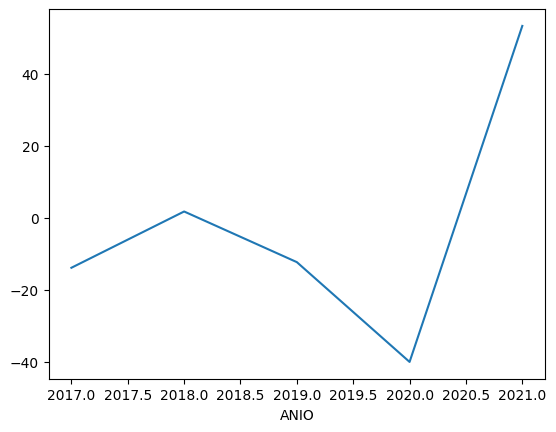

In [136]:
reduccion_obitos_moto.plot()

### CONCLUSION

Se espera una reducción del 7% en la cantidad de obitos en Moto, se aprecia una reducción sustancial del 42 % hacia el inicio del 2020, que luego comienza a incrementar enel transcurso del 2020 llegando a un aumento del 55.17% hacia el 2021. Se puede intuir que el tiempo de aislamiento durante la pandemia aportó en la reducción de accidentes seguidos de obitos, para luego incrementarse vertiginosamente,hacia la vuelta a las calles luego dela pandemia, lo cual influira en muchos factores referentes al estadodeánimo y psicologico de la población, como económico.


### MAPAS
#### 1. ZONAS CON MAYOR TASA DE ACCIDENTES CON OBITO
#### 2. COMPARACIÓN ENTRE ACCIDENTES CON LESIONES (AZUL) Y ACCIDENTES CON ÓBITOS (ROJO)

In [139]:
mapa = accidentes.loc[accidentes['OBITO'] == 1, ['X', 'Y']]
mapa = mapa.dropna(subset=['X', 'Y'])
print(mapa)

               X          Y
0     -58.475340 -34.687570
1     -58.508775 -34.669777
2     -58.390403 -34.631894
3     -58.465039 -34.680930
4     -58.387183 -34.622466
...          ...        ...
713   -58.467398 -34.651178
714   -58.472934 -34.619847
715   -58.470668 -34.650217
716   -58.379762 -34.586796
17252 -58.466449 -34.700942

[705 rows x 2 columns]


In [140]:
mapa = mapa.dropna(subset=['X', 'Y'])

centro_mapa = [mapa['Y'].mean(), mapa['X'].mean()]
mapa_obitos = folium.Map(location=centro_mapa, zoom_start=12)
heat_data = [[row['Y'], row['X']] for index, row in mapa.iterrows()]
HeatMap(heat_data, radius=17, cmap='inferno', gradient={.5: 'purple', .6: 'blue', 1: 'red'}).add_to(mapa_obitos)

mapa_obitos.save('mapa_obitos.html')

In [141]:
mapa_obitos

In [145]:
mapa1 = accidentes[['X', 'Y', 'OBITO']].copy()

mapa1 = mapa1.dropna(subset=['X', 'Y', 'OBITO'])

In [146]:
mapa1

,X,Y,OBITO
0,-58.475340,-34.687570,1
1,-58.508775,-34.669777,1
2,-58.390403,-34.631894,1
3,-58.465039,-34.680930,1
4,-58.387183,-34.622466,1
...,...,...,...
26568,-58.432886,-34.619702,0
26569,-58.513477,-34.659714,0
26570,-58.488327,-34.641753,0
26571,-58.488327,-34.641753,0


In [147]:
centro_mapa = [mapa1['Y'].mean(), mapa1['X'].mean()]
mapaObitosyLesiones = folium.Map(location=centro_mapa, zoom_start=13)

for index, row in mapa1.iterrows():
    if row['OBITO'] == 1:
        radius = 10  
        color = 'red'
    else:
        radius = .8
        color = 'blue'
    folium.CircleMarker(
        location=[row['Y'], row['X']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.4,
        popup=f"Ubicación: {row['Y']}, {row['X']}\nOBITO: {row['OBITO']}"
    ).add_to(mapaObitosyLesiones)

mapaObitosyLesiones.save('mapaObitosyLesiones.html')

In [148]:
mapaObitosyLesiones

Cambio los '.' por ',' con el fin de ser mejor mas ágil el uso de las coordenadas en Power BI

In [149]:
accidentes = accidentes.dropna(subset=['X', 'Y'])

accidentes["X"] = accidentes["X"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))
accidentes["Y"] = accidentes["Y"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))

In [150]:
accidentes_obitos["X"] = accidentes_obitos["X"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))
accidentes_obitos["Y"] = accidentes_obitos["Y"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [151]:
accidentes_lesiones["X"] = accidentes_lesiones["X"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))
accidentes_lesiones["Y"] = accidentes_lesiones["Y"].map(lambda x: "{:,.2f}".format(x).replace(".", ","))


In [152]:
tabla_obitos.to_csv('DATA/kpi1.csv', index=False)
tabla_obitos_moto.to_csv('DATA/kpi2.csv', index=False)
accidentes_obitos.to_csv('DATA/accidentes_obitos.csv', index=False)
accidentes_lesiones.to_csv('DATA/accidentes_lesiones.csv', index=False)